# Predict learning time

In [1]:
prefix = '/home/ines/repositories/'
# prefix = '/Users/ineslaranjeira/Documents/Repositories/'

In [32]:
""" 
IMPORTS
"""
import os
import autograd.numpy as np
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
# --Machine learning and statistics
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler,  LabelBinarizer
from sklearn.cluster import KMeans
import random
from sklearn import mixture
import pickle
from scipy.stats import mode
from sklearn.inspection import permutation_importance
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import RidgeCV


# --Machine learning and statistics
from sklearn.model_selection import KFold
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import f1_score, confusion_matrix
from sklearn.preprocessing import OneHotEncoder
from scipy.stats import entropy
from scipy import stats

# Get my functions
functions_path =  prefix + 'representation_learning_variability/Functions/'
os.chdir(functions_path)
from data_processing import save_and_log
functions_path =  prefix + 'representation_learning_variability/Models/Sub-trial//2_fit_models/'
os.chdir(functions_path)
from preprocessing_functions import idxs_from_files
functions_path =  prefix + 'representation_learning_variability/Models/Sub-trial//3_postprocess_results/'
os.chdir(functions_path)
from plotting_functions import create_grouped_gradient_palette

from one.api import ONE
one = ONE(mode='remote')

## Parameters

In [3]:
# Parameters
bin_size = 0.017
num_states = 2
threshold = 0.0
optimal_k = 4

save_path = prefix + 'representation_learning_variability/DATA/Sub-trial/Results/'  + str(bin_size) + '/'+str(num_states)+'_states/most_likely_states/'

# LOAD DATA
data_path = prefix + 'representation_learning_variability/DATA/Sub-trial/Design matrix/' + 'v5_15Jan2025/' + str(bin_size) + '/'
all_files = os.listdir(data_path)
design_matrices = [item for item in all_files if 'design_matrix' in item and 'standardized' not in item]
idxs, mouse_names = idxs_from_files(design_matrices, bin_size)

states_path =  prefix + 'representation_learning_variability/DATA/Sub-trial/Results/' + str(bin_size) + '/'+str(num_states)+'_states/most_likely_states/'
wavelet_states_path = prefix + 'representation_learning_variability/DATA/Sub-trial/Results/'  + str(bin_size) + '/wavelet_transform_states/'

path_sets = [wavelet_states_path, states_path, states_path]


# Individual sessions

In [4]:
# Identify sessions available to process
sessions_to_process = []
for m, mat in enumerate(idxs):
    mouse_name = mat[37:]
    session = mat[:36]
    fit_id = str(mouse_name + session)
    whisker_filename = os.path.join(states_path, "most_likely_states" + 'whisker_me' + '_' + fit_id)
    licks_filename = os.path.join(states_path, "most_likely_states" + 'Lick count' + '_' + fit_id)
    wavelet_filename = os.path.join(wavelet_states_path, "most_likely_states_" + str(optimal_k) + '_' + fit_id)

    if os.path.exists(whisker_filename) and os.path.exists(licks_filename) and os.path.exists(wavelet_filename):
        sessions_to_process.append((mouse_name, session))

print(f"Found {len(sessions_to_process)} sessions to process.")

Found 215 sessions to process.


## Get sequences per session

In [5]:
# Load trial clsuters
results_path = prefix + 'representation_learning_variability/Models/Sub-trial/4_analyses/'
filename = str(results_path + 'cluster_per_trial_no_timing03-19-2025')
trial_clusters = pd.read_parquet(filename, engine='pyarrow')

## Get sequence of trial modes

In [6]:
plot = False
target_length = 3

all_sequences = pd.DataFrame(columns=['session', 'mouse_name', 'trial_type', 'cluster', 'bin'])
for s, session in enumerate(trial_clusters['session'].unique()):

    # Get session data and order trials
    session_data = trial_clusters.loc[trial_clusters['session']==session]
    session_data = session_data[['session', 'mouse_name', 'trial_id', 'trial_type', 'cluster']].drop_duplicates()
    session_data['trial_id'] = session_data['trial_id'].astype(float)
    session_data = session_data.sort_values(by=['trial_id'])

    # Bin 
    n_trials = len(session_data)
    # Assign bin index: split into 10 parts
    bin_indices = pd.qcut(np.arange(n_trials), q=target_length, labels=False)
    session_data['bin'] = bin_indices
      
    all_sequences = pd.concat([all_sequences, session_data[['session', 'mouse_name',
                                                            'trial_type', 'cluster', 'bin']]], ignore_index=True)


In [7]:
fractions = all_sequences.groupby(['session', 'mouse_name',
                                   'bin'])['cluster'].value_counts(normalize=True).rename('fraction').reset_index().sort_values(by=['bin', 'cluster'])


In [8]:
design_df = fractions.pivot(index=['mouse_name', 'session'], columns=['bin', 'cluster'], values='fraction').reset_index().fillna(0)
var_names = design_df.keys()[2:]
final_matrix = design_df[var_names]

([<matplotlib.axis.XTick at 0x755e43333d00>], [Text(0, 0, '0')])

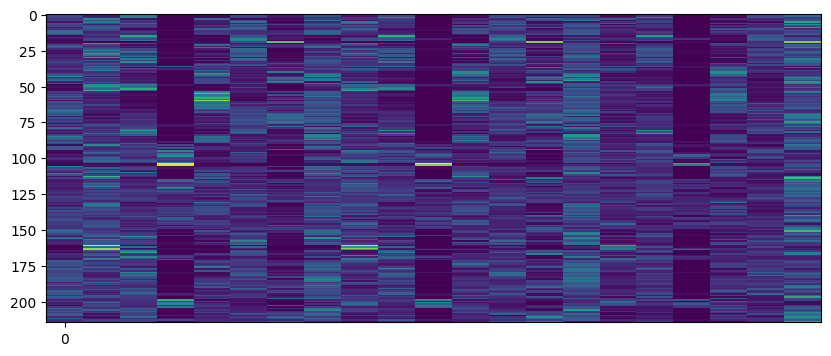

In [9]:
plt.figure(figsize=(10, 4))
plt.imshow(final_matrix, aspect='auto', cmap='viridis', interpolation='none')
plt.xticks(np.arange(0, np.shape(final_matrix)[1], 160), np.arange(0, np.shape(final_matrix)[1], 160))

## Get learning speed

In [10]:
data_path = prefix + 'representation_learning_variability/DATA/'
# data_path =  '/Users/ineslaranjeira/Documents/Repositories/representation_learning_variability/DATA/'
learning_df = pd.read_csv(data_path+'learning_private_one.csv')  
learning_times = learning_df[['subject_nickname', 'training_time']].drop_duplicates()
learning_times = learning_times.rename(columns={"subject_nickname": "mouse_name"}).reset_index()

data_path =  prefix + 'representation_learning_variability/DATA/'
learning_df = pd.read_parquet(data_path+'training_time_03-21-2025', engine='pyarrow')
learning_times_new = learning_df.rename(columns={"subject_nickname": "mouse_name"}).reset_index()

new_df = design_df.droplevel(1, axis=1)[['mouse_name', 'session']]
df = new_df.merge(learning_times, on='mouse_name')
a = learning_times.merge(learning_times_new, on='mouse_name', how='outer')
b = a.loc[a['training_time_x'].isna()]
b = b.rename(columns={"training_time_y": "training_time"}).reset_index()

full_learning = pd.concat([learning_times[['mouse_name', 'training_time']], b[['mouse_name', 'training_time']]]).reset_index()

/tmp/ipykernel_10433/1940241136.py:3: DtypeWarning: Columns (23) have mixed types. Specify dtype option on import or set low_memory=False.
  learning_df = pd.read_csv(data_path+'learning_private_one.csv')


In [11]:
df =design_df.droplevel(1, axis=1).merge(learning_times_new, on=['mouse_name'])
df['quartile'] = pd.qcut(df['training_time'], q=[0, .25, .5, .75, 1], labels=[1, 2, 3, 4])
# df['quartile'] = pd.qcut(df['training_time'], q=[0, .33, .66, 1], labels=[1, 2, 3])
# df['quartile'] = pd.qcut(df['training_time'], q=[0, .1, .2, .3, .4, .5, .6, .7, .8, .9, 1], 
#                          labels=[1, 2, 3, 4, 5, 6, 7, 8, 9, 10])

- select training set (leave one subject out)
## 1. Correlate syllable probability with learning speed
- compute probability of each syllable per timestep
- correlate syllable probability and learning speed
- select significantly correlated features and save
## 2. Build linear models
- compute positive and negative strength for each subject in the training set, as a sum of features significantly correlated
- linear models relate strength and training time vectors in the training data
## 3. Predict on test set
- using the models from 2 trained on all mice except one, predict the training time of that one, by inputting its positive or negative strength


# Get data of interest for decoder

In [12]:
mat = pd.DataFrame(np.array(df[[0, 1, 2]]), columns=np.arange(0, 21, 1))
mat
# mat = mat.drop(columns=['index', 'training_time', 'mouse_name', 'session'])
# mat = pd.DataFrame(final_matrix)
mat['training_time'] = df['training_time']
mat['mouse_number'] =  pd.factorize(df['mouse_name'])[0]
# mat = mat.rename(columns=dict(zip(np.array(mat.keys()[:21]), np.arange(0, 21, 1))))
named_labels = mat['training_time'].drop_duplicates()

In [26]:
modes = np.arange(0, 21, 1)
# modes = df.keys()[2:-3]

y_df = pd.DataFrame(columns=['mouse_number', 'training_time', 'predicted_time'])
y_df['mouse_number'] = list(mat['mouse_number'])
y_df['training_time'] = list(np.log(mat['training_time']))
# y_df['training_time'] = list(mat['training_time'])
y_df = y_df.drop_duplicates().reset_index()

use_mat = mat.copy()
use_mat['training_time'] = np.log(mat['training_time'])
sign_feat_count = np.zeros(len(use_mat['mouse_number'].drop_duplicates()))

for m, mouse in enumerate(use_mat['mouse_number'].drop_duplicates()):
    
    print('Processing mouse '+str(mouse))
    
    training = use_mat.loc[use_mat['mouse_number']!=m]
    pearson_df = pd.DataFrame(columns=['mode', 'pearson', 'p_value'], index=modes)

    prob_syllable = training.groupby(['mouse_number', 'training_time'])[modes].mean().reset_index()

    for s, syllable in enumerate(modes):
        
        x = np.sqrt(prob_syllable[s])
        y = prob_syllable['training_time']
        
        pearson, p_value = stats.pearsonr(x, y)
        
        # Save data
        pearson_df['mode'][s] = s
        pearson_df['pearson'][s] = pearson
        pearson_df['p_value'][s] = p_value
        
        # if p_value <= 0.05:
        #     plt.scatter(x, y)
        #     plt.title(str(syllable - np.floor(syllable/16) * 16))
        #     plt.show()
    
        # Construct feature strength per subject
    training_mice = training.mouse_number.unique()
    significant_features = np.array(pearson_df.loc[pearson_df['p_value']<0.05, 'mode'])
    sign_feat_count[m] = len(significant_features)



Processing mouse 0
Processing mouse 1
Processing mouse 2
Processing mouse 3
Processing mouse 4
Processing mouse 5
Processing mouse 6
Processing mouse 7
Processing mouse 8
Processing mouse 9
Processing mouse 10
Processing mouse 11
Processing mouse 12
Processing mouse 13
Processing mouse 14
Processing mouse 15
Processing mouse 16
Processing mouse 17
Processing mouse 18
Processing mouse 19
Processing mouse 20
Processing mouse 21
Processing mouse 22
Processing mouse 23
Processing mouse 24
Processing mouse 25
Processing mouse 26
Processing mouse 27
Processing mouse 28
Processing mouse 29
Processing mouse 30


/tmp/ipykernel_10433/648583580.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/648583580.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting v

Processing mouse 31
Processing mouse 32
Processing mouse 33
Processing mouse 34
Processing mouse 35
Processing mouse 36
Processing mouse 37
Processing mouse 38
Processing mouse 39
Processing mouse 40
Processing mouse 41
Processing mouse 42
Processing mouse 43
Processing mouse 44
Processing mouse 45
Processing mouse 46
Processing mouse 47
Processing mouse 48
Processing mouse 49
Processing mouse 50
Processing mouse 51
Processing mouse 52
Processing mouse 53
Processing mouse 54
Processing mouse 55
Processing mouse 56
Processing mouse 57
Processing mouse 58
Processing mouse 59
Processing mouse 60
Processing mouse 61
Processing mouse 62
Processing mouse 63


/tmp/ipykernel_10433/648583580.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/648583580.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting v

Processing mouse 64
Processing mouse 65
Processing mouse 66
Processing mouse 67
Processing mouse 68
Processing mouse 69
Processing mouse 70
Processing mouse 71
Processing mouse 72
Processing mouse 73
Processing mouse 74
Processing mouse 75
Processing mouse 76
Processing mouse 77
Processing mouse 78
Processing mouse 79
Processing mouse 80


/tmp/ipykernel_10433/648583580.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/648583580.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting v

In [36]:
modes = np.arange(0, 21, 1)
# modes = df.keys()[2:-3]

y_df = pd.DataFrame(columns=['mouse_number', 'training_time', 'predicted_time'])
y_df['mouse_number'] = list(mat['mouse_number'])
y_df['training_time'] = list(np.log(mat['training_time']))
# y_df['training_time'] = list(mat['training_time'])
y_df = y_df.drop_duplicates().reset_index()

use_mat = mat.copy()
use_mat['training_time'] = np.log(mat['training_time'])
sign_feat_count = np.zeros(len(use_mat['mouse_number'].drop_duplicates()))

for m, mouse in enumerate(use_mat['mouse_number'].drop_duplicates()):
    
    print('Processing mouse '+str(mouse))
    
    training = use_mat.loc[use_mat['mouse_number']!=m]
    pearson_df = pd.DataFrame(columns=['mode', 'pearson', 'p_value'], index=modes)

    prob_syllable = training.groupby(['mouse_number', 'training_time'])[modes].mean().reset_index()

    for s, syllable in enumerate(modes):
        
        x = np.sqrt(prob_syllable[s])
        y = prob_syllable['training_time']
        
        pearson, p_value = stats.spearmanr(x, y)
        
        # Save data
        pearson_df['mode'][s] = s
        pearson_df['pearson'][s] = pearson
        pearson_df['p_value'][s] = p_value
        
    
        # Construct feature strength per subject
    training_mice = training.mouse_number.unique()
    significant_features = np.array(pearson_df.loc[pearson_df['p_value']<0.05, 'mode'])
    sign_feat_count[m] = len(significant_features)

    X_train = np.ones((len(training_mice), len(significant_features))) * np.nan
    y_train = np.ones(len(training_mice)) * np.nan
    for mm, mmouse in enumerate(training_mice):
        
        mouse_vector = np.sqrt(training.loc[training['mouse_number']==mmouse, modes].mean(axis=0))
        X_train[mm, :] = mouse_vector[significant_features]
        y_train[mm] = list(prob_syllable.loc[prob_syllable['mouse_number']==mmouse, 'training_time'])[0]
    
    # Train model leaving one out
    X = np.vstack([X_train.T, np.ones(len(training_mice))]).T
    # ols = LinearRegression(fit_intercept=False)
    # ols.fit(np.array(X), np.array(y_train))
    model = RidgeCV(alphas=np.logspace(-3, 3, 10)).fit(np.array(X), np.array(y_train))

    # Predict test mouse
    test = use_mat.loc[use_mat['mouse_number']==m]
    test_prob_syllable = test.groupby(['mouse_number', 'training_time'])[modes].mean().reset_index()
    X_test = np.array(test_prob_syllable[significant_features])
    
    new_X = np.vstack([X_test.T, np.ones(1)]).T
    # predicted_time = ols.predict(new_X)
    predicted_time = model.predict(new_X)

    # Save
    y_df.loc[y_df['mouse_number']==m, 'predicted_time'] = np.round(predicted_time[0], 3)
    
    
      
    # # # Plot pearson values
    # # plt.hist(pearson_df.loc[pearson_df['p_value']>0.1, 'pearson'], alpha=0.4)
    # # plt.hist(pearson_df.loc[pearson_df['p_value']<0.1, 'pearson'], alpha=0.8)
    # # plt.show()
    
    # # Construct feature strength per subject
    # training_mice = training.mouse_number.unique()
    # positive_features = np.array(pearson_df.loc[(pearson_df['p_value']<0.01) & (pearson_df['pearson']>0), 'mode'])
    # negative_features = np.array(pearson_df.loc[(pearson_df['p_value']<0.01) & (pearson_df['pearson']<0), 'mode'])
    
    # feature_strength_df = pd.DataFrame(columns=['mouse_number', 'training_time', 'positive_strength', 'negative_strength'], index=range(len(training_mice)))
    # for mm, mmouse in enumerate(training_mice):
        
    #     mouse_vector = training.loc[training['mouse_number']==mmouse, modes].mean(axis=0)
    #     positive_strength = mouse_vector[positive_features].sum()
    #     negative_strength = mouse_vector[negative_features].sum()
        
    #     # Save
    #     feature_strength_df['mouse_number'][mm] = mmouse
    #     feature_strength_df['training_time'][mm] = list(prob_syllable.loc[prob_syllable['mouse_number']==mmouse, 'training_time'])[0]
    #     feature_strength_df['positive_strength'][mm] = positive_strength
    #     feature_strength_df['negative_strength'][mm] = negative_strength
            
    
    # # Training set model
    # pos_x = feature_strength_df['positive_strength']
    # neg_x = feature_strength_df['negative_strength']
    # y = feature_strength_df['training_time']

    # pos_x = np.array(feature_strength_df['positive_strength'])
    # neg_x = np.array(feature_strength_df['negative_strength'])
    # y = np.array(feature_strength_df['training_time'])

    # X_pos = np.vstack([pos_x, np.ones(len(pos_x))]).T
    # ols_pos = LinearRegression(fit_intercept=False)
    # ols_pos.fit(np.array(X_pos), np.array(y))
    # # slope, intersect = np.linalg.lstsq(X_pos.astype('float'), y.astype('float'))[0]

    # X_neg = np.vstack([neg_x, np.ones(len(neg_x))]).T
    # ols_neg = LinearRegression(fit_intercept=False)
    # ols_neg.fit(np.array(X_neg), np.array(y))
    
    # X = np.vstack([pos_x, neg_x, np.ones(len(neg_x))]).T
    # ols = LinearRegression(fit_intercept=False)
    # ols.fit(np.array(X), np.array(y))
    
    # # plt.scatter(pos_x, y)
    # # # plt.scatter(neg_x, y)
    # # # # plt.scatter(X, y)
    # # new_x = np.arange(0, 10, 1)
    # # # new_X = np.vstack([new_x, np.ones(len(new_x))]).T
    # # slope = ols_pos.coef_[0]
    # # intercept = ols_pos.coef_[1]
    # # plt.plot(
    # #     new_x,
    # #     slope* new_x + intercept,
    # #     label="Linear Regression Model",
    # #     linewidth=1,
    # # )
    # # plt.xlabel('Feature strength')
    # # plt.ylabel('Training time (log sessions)')
    # # plt.title('Positive')
    # # plt.show()

    # # Predict test mouse
    # test = use_mat.loc[use_mat['mouse_number']==m]
    # test_prob_syllable = test.groupby(['mouse_number', 'training_time'])[modes].mean().reset_index()
    # positive_mouse_strength = np.array(test_prob_syllable[positive_features]).sum()
    # negative_mouse_strength = np.array(test_prob_syllable[negative_features]).sum()
    
    # new_pos_X = np.vstack([positive_mouse_strength, np.ones(1)]).T
    # new_neg_X = np.vstack([negative_mouse_strength, np.ones(1)]).T
    # predicted_time_pos = ols_pos.predict(new_pos_X)
    # predicted_time_neg = ols_neg.predict(new_neg_X)
    # new_X = np.vstack([positive_mouse_strength, negative_mouse_strength, np.ones(1)]).T
    # predicted_time = ols.predict(new_X)

    # # Save
    # y_df.loc[y_df['mouse_number']==m, 'predicted_pos'] = np.round(predicted_time_pos[0], 3)
    # y_df.loc[y_df['mouse_number']==m, 'predicted_neg'] = np.round(predicted_time_neg[0], 3)
    # y_df.loc[y_df['mouse_number']==m, 'predicted_time'] = np.round(predicted_time[0], 3)

Processing mouse 0
Processing mouse 1
Processing mouse 2


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 3
Processing mouse 4
Processing mouse 5


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 6
Processing mouse 7
Processing mouse 8
Processing mouse 9


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 10
Processing mouse 11
Processing mouse 12
Processing mouse 13


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 14
Processing mouse 15
Processing mouse 16
Processing mouse 17


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 18
Processing mouse 19
Processing mouse 20
Processing mouse 21


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 22
Processing mouse 23
Processing mouse 24


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 25
Processing mouse 26
Processing mouse 27


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 28
Processing mouse 29
Processing mouse 30


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 31
Processing mouse 32
Processing mouse 33
Processing mouse 34


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 35
Processing mouse 36
Processing mouse 37
Processing mouse 38


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 39
Processing mouse 40
Processing mouse 41
Processing mouse 42


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 43
Processing mouse 44
Processing mouse 45
Processing mouse 46


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 47
Processing mouse 48
Processing mouse 49
Processing mouse 50


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 51
Processing mouse 52
Processing mouse 53
Processing mouse 54


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 55
Processing mouse 56
Processing mouse 57
Processing mouse 58


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 59
Processing mouse 60
Processing mouse 61


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 62
Processing mouse 63
Processing mouse 64
Processing mouse 65


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 66
Processing mouse 67
Processing mouse 68
Processing mouse 69


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 70
Processing mouse 71
Processing mouse 72
Processing mouse 73


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 74
Processing mouse 75
Processing mouse 76
Processing mouse 77


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

Processing mouse 78
Processing mouse 79
Processing mouse 80


/tmp/ipykernel_10433/1027010862.py:31: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_10433/1027010862.py:32: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting

In [50]:
model.score(X, y_train)

0.0887974664741551

(-0.37730437483468326, 0.0005161461021205025)

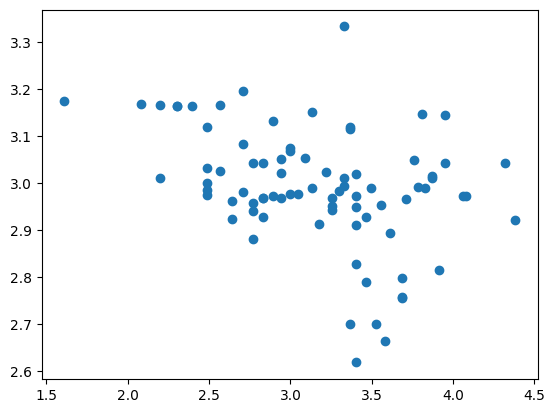

In [37]:
plt.scatter(y_df['training_time'], y_df['predicted_time'])
# plt.xlim([1.5, 4.5])
# plt.ylim([1.5, 4.5])
res = stats.pearsonr(np.array(y_df['training_time']), np.array(y_df['predicted_time']))
res

In [138]:
modes = np.arange(0, 21, 1)
# modes = df.keys()[2:-3]

y_df = pd.DataFrame(columns=['mouse_number', 'training_time', 'predicted_pos', 'predicted_neg', 'predicted_time'])
y_df['mouse_number'] = list(mat['mouse_number'])
y_df['training_time'] = list(np.log(mat['training_time']))
# y_df['training_time'] = list(mat['training_time'])
y_df['predicted_pos'] = y_df['training_time'] * np.nan
y_df['predicted_neg'] = y_df['training_time'] * np.nan
y_df['predicted_time'] = y_df['training_time'] * np.nan
y_df = y_df.drop_duplicates().reset_index()

use_mat = mat.copy()
use_mat['training_time'] = np.log(mat['training_time'])

for m, mouse in enumerate(use_mat['mouse_number'].drop_duplicates()):
    
    print('Processing mouse '+str(mouse))
    
    training = use_mat.loc[use_mat['mouse_number']!=m]
    pearson_df = pd.DataFrame(columns=['mode', 'pearson', 'p_value'], index=modes)

    prob_syllable = training.groupby(['mouse_number', 'training_time'])[modes].mean().reset_index()

    for s, syllable in enumerate(modes):
        
        x = prob_syllable[s]
        y = prob_syllable['training_time']
        
        pearson, p_value = stats.pearsonr(x, y)
        
        # Save data
        pearson_df['mode'][s] = s
        pearson_df['pearson'][s] = pearson
        pearson_df['p_value'][s] = p_value
        
    # # Plot pearson values
    # plt.hist(pearson_df.loc[pearson_df['p_value']>0.1, 'pearson'], alpha=0.4)
    # plt.hist(pearson_df.loc[pearson_df['p_value']<0.1, 'pearson'], alpha=0.8)
    # plt.show()
    
    # Construct feature strength per subject
    training_mice = training.mouse_number.unique()
    positive_features = np.array(pearson_df.loc[(pearson_df['p_value']<0.01) & (pearson_df['pearson']>0), 'mode'])
    negative_features = np.array(pearson_df.loc[(pearson_df['p_value']<0.01) & (pearson_df['pearson']<0), 'mode'])
    
    feature_strength_df = pd.DataFrame(columns=['mouse_number', 'training_time', 'positive_strength', 'negative_strength'], index=range(len(training_mice)))
    for mm, mmouse in enumerate(training_mice):
        
        mouse_vector = training.loc[training['mouse_number']==mmouse, modes].mean(axis=0)
        positive_strength = mouse_vector[positive_features].sum()
        negative_strength = mouse_vector[negative_features].sum()
        
        # Save
        feature_strength_df['mouse_number'][mm] = mmouse
        feature_strength_df['training_time'][mm] = list(prob_syllable.loc[prob_syllable['mouse_number']==mmouse, 'training_time'])[0]
        feature_strength_df['positive_strength'][mm] = positive_strength
        feature_strength_df['negative_strength'][mm] = negative_strength
            
    
    # Training set model
    pos_x = feature_strength_df['positive_strength']
    neg_x = feature_strength_df['negative_strength']
    y = feature_strength_df['training_time']

    pos_x = np.array(feature_strength_df['positive_strength'])
    neg_x = np.array(feature_strength_df['negative_strength'])
    y = np.array(feature_strength_df['training_time'])

    X_pos = np.vstack([pos_x, np.ones(len(pos_x))]).T
    ols_pos = LinearRegression(fit_intercept=False)
    ols_pos.fit(np.array(X_pos), np.array(y))
    # slope, intersect = np.linalg.lstsq(X_pos.astype('float'), y.astype('float'))[0]

    X_neg = np.vstack([neg_x, np.ones(len(neg_x))]).T
    ols_neg = LinearRegression(fit_intercept=False)
    ols_neg.fit(np.array(X_neg), np.array(y))
    
    X = np.vstack([pos_x, neg_x, np.ones(len(neg_x))]).T
    ols = LinearRegression(fit_intercept=False)
    ols.fit(np.array(X), np.array(y))
    
    # plt.scatter(pos_x, y)
    # # plt.scatter(neg_x, y)
    # # # plt.scatter(X, y)
    # new_x = np.arange(0, 10, 1)
    # # new_X = np.vstack([new_x, np.ones(len(new_x))]).T
    # slope = ols_pos.coef_[0]
    # intercept = ols_pos.coef_[1]
    # plt.plot(
    #     new_x,
    #     slope* new_x + intercept,
    #     label="Linear Regression Model",
    #     linewidth=1,
    # )
    # plt.xlabel('Feature strength')
    # plt.ylabel('Training time (log sessions)')
    # plt.title('Positive')
    # plt.show()

    # Predict test mouse
    test = use_mat.loc[use_mat['mouse_number']==m]
    test_prob_syllable = test.groupby(['mouse_number', 'training_time'])[modes].mean().reset_index()
    positive_mouse_strength = np.array(test_prob_syllable[positive_features]).sum()
    negative_mouse_strength = np.array(test_prob_syllable[negative_features]).sum()
    
    new_pos_X = np.vstack([positive_mouse_strength, np.ones(1)]).T
    new_neg_X = np.vstack([negative_mouse_strength, np.ones(1)]).T
    predicted_time_pos = ols_pos.predict(new_pos_X)
    predicted_time_neg = ols_neg.predict(new_neg_X)
    new_X = np.vstack([positive_mouse_strength, negative_mouse_strength, np.ones(1)]).T
    predicted_time = ols.predict(new_X)

    # Save
    y_df.loc[y_df['mouse_number']==m, 'predicted_pos'] = np.round(predicted_time_pos[0], 3)
    y_df.loc[y_df['mouse_number']==m, 'predicted_neg'] = np.round(predicted_time_neg[0], 3)
    y_df.loc[y_df['mouse_number']==m, 'predicted_time'] = np.round(predicted_time[0], 3)


Processing mouse 0
Processing mouse 1
Processing mouse 2


/tmp/ipykernel_9051/4109706251.py:33: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_9051/4109706251.py:34: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting v

Processing mouse 3
Processing mouse 4
Processing mouse 5


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 6
Processing mouse 7
Processing mouse 8


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 9
Processing mouse 10
Processing mouse 11


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 12
Processing mouse 13
Processing mouse 14


/tmp/ipykernel_9051/4109706251.py:33: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_9051/4109706251.py:34: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting v

Processing mouse 15
Processing mouse 16
Processing mouse 17


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 18
Processing mouse 19
Processing mouse 20


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 21
Processing mouse 22
Processing mouse 23


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 24
Processing mouse 25
Processing mouse 26


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 27
Processing mouse 28
Processing mouse 29


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 30
Processing mouse 31
Processing mouse 32


/tmp/ipykernel_9051/4109706251.py:33: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  pearson_df['mode'][s] = s
/tmp/ipykernel_9051/4109706251.py:34: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting v

Processing mouse 33
Processing mouse 34
Processing mouse 35


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 36
Processing mouse 37
Processing mouse 38


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 39
Processing mouse 40
Processing mouse 41


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 42
Processing mouse 43
Processing mouse 44


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 45
Processing mouse 46
Processing mouse 47


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 48
Processing mouse 49
Processing mouse 50


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 51
Processing mouse 52
Processing mouse 53


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 54
Processing mouse 55
Processing mouse 56


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 57
Processing mouse 58
Processing mouse 59


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 60
Processing mouse 61
Processing mouse 62


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 63
Processing mouse 64
Processing mouse 65


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 66
Processing mouse 67
Processing mouse 68


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 69
Processing mouse 70
Processing mouse 71


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 72
Processing mouse 73
Processing mouse 74


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 75
Processing mouse 76
Processing mouse 77


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

Processing mouse 78
Processing mouse 79
Processing mouse 80


/tmp/ipykernel_9051/4109706251.py:55: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  feature_strength_df['mouse_number'][mm] = mmouse
/tmp/ipykernel_9051/4109706251.py:56: FutureWarning: ChainedAssignmentError: behaviour will change in pandas

In [147]:
pos_x = np.array(feature_strength_df['positive_strength'])
neg_x = np.array(feature_strength_df['negative_strength'])
y = np.array(feature_strength_df['training_time'])

X_pos = np.vstack([pos_x, np.ones(len(pos_x))]).T
ols_pos = LinearRegression(fit_intercept=False)
ols_pos.fit(np.array(X_pos), np.array(y))

LinearRegression(fit_intercept=False)

Text(0.5, 1.0, 'Positive')

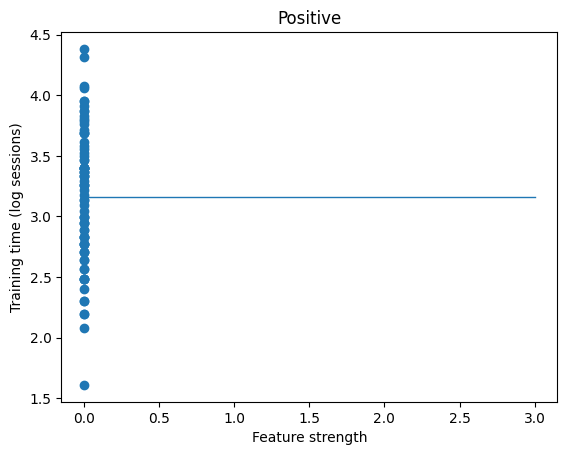

In [142]:
plt.scatter(feature_strength_df['positive_strength'], feature_strength_df['training_time'])
new_x = np.arange(0, 4, 1)
# new_X = np.vstack([new_x, np.ones(len(new_x))]).T
slope = ols_pos.coef_[0]
intercept = ols_pos.coef_[1]
plt.plot(
    new_x,
    slope* new_x + intercept,
    label="Linear Regression Model",
    linewidth=1,
)
plt.xlabel('Feature strength')
plt.ylabel('Training time (log sessions)')
plt.title('Positive')
# plt.show()
# plt.scatter(feature_strength_df['negative_strength'], feature_strength_df['training_time'])

In [148]:
plt.scatter(np.log(y_df['training_time']), y_df['predicted_neg'])
# plt.xlim([1.5, 4.5])
# plt.ylim([1.5, 4.5])
res = stats.pearsonr(np.array(np.log(y_df['training_time'])), np.array(y_df['predicted_neg']))
res

KeyError: 'predicted_neg'